![BCC](https://bccfilkom.net/static/assets/images/BCC-Logo.svg)

# Rainfall Predictions

# Methodology

Our ability to use the data within the decision making process is either lost or not maximized as all too often, **we don't have a solid understanding of the questions being asked** and how to apply the data correctly to the problem at hand. It's important to consider it because all too often there is a temptation to bypass methodology and jump directly to solutions.

Let's start with explaining what a methodology is. *Methodology* is a system of methods used in a particular area of study or activity.

So in this project, I will be using methodology called *Foundational Methodology for Data Science*.

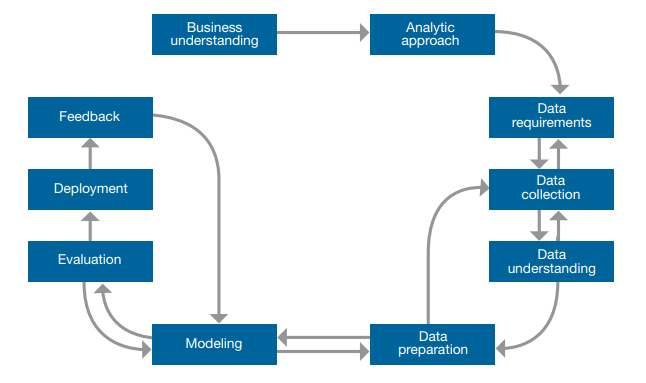

# Business understanding

.

# Analytic approach

.

# Data collection

In [1]:
import warnings
warnings.filterwarnings('ignore')

# Basic Library
import warnings
import os
import numpy as np
np.random.seed(7)
import pandas as pd
import statistics
import math
from timeit import default_timer as timer

# Preprocessing Library
#!pip install missingno
#import missingno as msno
from sklearn import metrics
from sklearn import preprocessing
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OrdinalEncoder
from sklearn.preprocessing import MinMaxScaler
import vtreat

# Visualization Library
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline 
import seaborn as sns
from scipy import stats
import missingno as mno

#import matplotlib.pylab as pylab

# Fast EDA
from dataprep.eda import create_report

# Dimentionality Reduction & Normalization Library
#from sklearn.preprocessing import normalize
#from sklearn.preprocessing import MinMaxScaler
#from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

# Machine Learning Library
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LinearRegression
from catboost import CatBoostRegressor
from xgboost import XGBRegressor
import xgboost as xgb
from sklearn.model_selection import GridSearchCV
import pickle
#!pip install pycaret
import pycaret

# Model Evaluation Library
from sklearn.model_selection import cross_val_score
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
#from sklearn.metrics import classification_report, confusion_matrix, accuracy_score


In [2]:
# Downgrading numpy to 1.23 for shap
#!pip install numpy==1.23

In [3]:
# Check the version
print(f'Matplotlib: {matplotlib.__version__}')
print(f'pandas: {pd.__version__}')
print(f'numpy: {np.__version__}')

Matplotlib: 3.7.2
pandas: 1.5.3
numpy: 1.23.5


In [4]:
# Get all files in the designated directory
directory_path = r"D:\[03] Work & Project\[01] Active Development\AIRNOLOGY-23"

for dirpath, _, filenames in os.walk(directory_path):
    for filename in filenames:
        print(os.path.join(dirpath, filename))

D:\[03] Work & Project\[01] Active Development\AIRNOLOGY-23\.gitignore
D:\[03] Work & Project\[01] Active Development\AIRNOLOGY-23\README.md
D:\[03] Work & Project\[01] Active Development\AIRNOLOGY-23\.git\COMMIT_EDITMSG
D:\[03] Work & Project\[01] Active Development\AIRNOLOGY-23\.git\config
D:\[03] Work & Project\[01] Active Development\AIRNOLOGY-23\.git\description
D:\[03] Work & Project\[01] Active Development\AIRNOLOGY-23\.git\FETCH_HEAD
D:\[03] Work & Project\[01] Active Development\AIRNOLOGY-23\.git\HEAD
D:\[03] Work & Project\[01] Active Development\AIRNOLOGY-23\.git\index
D:\[03] Work & Project\[01] Active Development\AIRNOLOGY-23\.git\ORIG_HEAD
D:\[03] Work & Project\[01] Active Development\AIRNOLOGY-23\.git\packed-refs
D:\[03] Work & Project\[01] Active Development\AIRNOLOGY-23\.git\hooks\applypatch-msg.sample
D:\[03] Work & Project\[01] Active Development\AIRNOLOGY-23\.git\hooks\commit-msg.sample
D:\[03] Work & Project\[01] Active Development\AIRNOLOGY-23\.git\hooks\fsmonito

In [5]:
SAMPLE_SUBMISSION_PATH = r'D:\[03] Work & Project\[01] Active Development\AIRNOLOGY-23\datasets\sample_submission.csv'

In [6]:
# Use double backslashes or forward slashes in the file path
path_train = r'D:\[03] Work & Project\[01] Active Development\AIRNOLOGY-23\datasets\train.csv'
path_test = r'D:\[03] Work & Project\[01] Active Development\AIRNOLOGY-23\datasets\test.csv'

# Read the CSV file into a DataFrame
train_dat = pd.read_csv(path_train)
test_dat = pd.read_csv(path_test)

# Data preparation I

In [7]:
# Check unique value
cols = train_dat.columns

for col in cols:
    print(f"{col} \t\n-> number of unique val: {train_dat[col].nunique()} \n-> unique val: {train_dat[col].unique()} \n -------------------------------- \n")

datetime 	
-> number of unique val: 341880 
-> unique val: [ 283996800  284000400  284004000 ... 1514754000 1514757600 1514761200] 
 -------------------------------- 

datetime_iso 	
-> number of unique val: 341880 
-> unique val: ['1979-01-01 00:00:00+00:00' '1979-01-01 01:00:00+00:00'
 '1979-01-01 02:00:00+00:00' ... '2017-12-31 21:00:00+00:00'
 '2017-12-31 22:00:00+00:00' '2017-12-31 23:00:00+00:00'] 
 -------------------------------- 

time-zone 	
-> number of unique val: 1 
-> unique val: [28800] 
 -------------------------------- 

temp 	
-> number of unique val: 9406 
-> unique val: ['24.75 Celcius' '24.58 C' '26.6 Celcius' ... '136.06 °C' '33.48 Celcius'
 '34.32 C'] 
 -------------------------------- 

visibility 	
-> number of unique val: 12 
-> unique val: [nan 'unidentified' ' ' '-1m' 'unrecognized' 'unknown' '-1 km' '-1'
 'empty' 'undefined' '-1km' '-1 m' 'missing'] 
 -------------------------------- 

d_point 	
-> number of unique val: 6121 
-> unique val: ['23.89  C' '23.

In [8]:
# temp
def prep_temp(temp):
    if isinstance(temp, str) :
        temp = temp.replace("Celcius", "")
        temp = temp.replace("C", "")
        temp = temp.replace("°", "")
        temp = temp.strip()
    return temp

In [9]:
# visibility


In [10]:
# datetime -> dihapus karena redundant
train_dat.drop(columns=["datetime"], inplace=True)
test_dat.drop(columns=["datetime"], inplace=True)

In [11]:
# Convert the 'timestamp' column to a datetime object
train_dat['datetime_iso'] = pd.to_datetime(train_dat['datetime_iso'])
test_dat['datetime_iso'] = pd.to_datetime(test_dat['datetime_iso'])

# Extract year, month, day, and hour
train_dat['year'] = train_dat['datetime_iso'].dt.year
train_dat['month'] = train_dat['datetime_iso'].dt.month
train_dat['day'] = train_dat['datetime_iso'].dt.day
train_dat['hour'] = train_dat['datetime_iso'].dt.hour

test_dat['year'] = test_dat['datetime_iso'].dt.year
test_dat['month'] = test_dat['datetime_iso'].dt.month
test_dat['day'] = test_dat['datetime_iso'].dt.day
test_dat['hour'] = test_dat['datetime_iso'].dt.hour

train_dat.drop(columns=["datetime_iso"], inplace=True)
test_dat.drop(columns=["datetime_iso"], inplace=True)

In [12]:
# time-zone -> dihapus karena data bukan unique
train_dat.drop(columns=["time-zone"], inplace=True)
test_dat.drop(columns=["time-zone"], inplace=True)

In [13]:
# prssr
def prep_prssr(prssr):
    if isinstance(prssr, str):
        prssr = prssr.replace("hPa.", "")
        prssr = prssr.replace("hPa", "")
        prssr = prssr.strip()
    return prssr

In [14]:
# sea_level

In [15]:
# grnd_level

In [16]:
# hum
def prep_hum(hum):
    if isinstance(hum, str):
        hum = hum.replace("%", "")
        hum = hum.strip()
    return hum

In [17]:
# wind_spd & wind_deg
def prep_wind(wind):
    if isinstance(wind, str):
        wind = wind.replace("m/s", "")
        wind = wind.replace("°", "")
        wind = wind.strip()
    return wind

In [18]:
# rain_1h
def prep_rain_1h(rain):
    if isinstance(rain, str):
        rain = rain.replace("mm", "")
        rain = rain.replace("zero", "0")
        rani = rain.replace(" ", "0")
        rain = rain.strip()
        try:
            float(rain)
            return rain
        except:
            new_rain = 0
            return new_rain
    return rain

In [19]:
# rain_3h -> 0 artinya ga hujan
def prep_rain_3h(rain):
    if isinstance(rain, str):
        rain = rain.replace("milimeter", "")
        rain = rain.replace("mm", "")
        rain = rain.replace("no-rain", "0")
        rain = rain.replace("volume:0", "0")
        rain = rain.replace("nol", "0")
        rain = rain.replace("no_rain", "0")
        rain = rain.replace("volume:zero", "0")
        rain = rain.replace("zero", "0")
        rain = rain.strip()
    return rain

In [20]:
# snow_1h
def prep_snow(snow):
    if isinstance(snow, str):
        snow = snow.replace("milimeter", "")
        snow = snow.replace("mm", "")
        snow = snow.replace("no-snow", "0")
        snow = snow.replace("volume:0", "0")
        snow = snow.replace("nol", "0")
        snow = snow.replace("no_snow", "0")
        snow = snow.replace("volume:zero", "0")
        snow = snow.replace("zero", "0")
        snow = snow.strip()
    return snow

In [21]:
# clouds
def prep_clouds(clouds):
    if isinstance(clouds, str):
        clouds = clouds.replace("%", "")
        clouds = clouds.strip()
    return clouds

In [22]:
preped_train = train_dat.copy()
preped_test = test_dat.copy()

# Prepping temp column --> including temp, d_point, feels, min_temp, max_temp
for column in ['temp','d_point','feels','min_temp','max_temp']:
    preped_train[column] = preped_train[column].apply(lambda x: prep_temp(x))
    preped_test[column] = preped_test[column].apply(lambda x: prep_temp(x))

# Prepping prssr column
for column in ['prssr']:
    preped_train[column] = preped_train[column].apply(lambda x:prep_prssr(x))
    preped_test[column] = preped_test[column].apply(lambda x:prep_prssr(x))

# Prepping hum column
for column in ['hum']:
    preped_train[column] = preped_train[column].apply(lambda x:prep_hum(x))
    preped_test[column] = preped_test[column].apply(lambda x:prep_hum(x))

# Prepping wind column --> including wind_spd, wind_deg
for column in ['wind_spd', 'wind_deg']:
    preped_train[column] = preped_train[column].apply(lambda x:prep_wind(x))
    preped_test[column] = preped_test[column].apply(lambda x:prep_wind(x))

# Prepping rain_1h
for column in ['rain_1h']:
    preped_train[column] = preped_train[column].apply(lambda x:prep_rain_1h(x))

# Prepping rain_3h column
for column in ['rain_3h']:
    preped_train[column] = preped_train[column].apply(lambda x:prep_rain_3h(x))
    preped_test[column] = preped_test[column].apply(lambda x:prep_rain_3h(x))

# Prepping snow column --> including snow_1h, snow_3h
for column in ['snow_1h', 'snow_3h']:
    preped_train[column] = preped_train[column].apply(lambda x:prep_snow(x))
    preped_test[column] = preped_test[column].apply(lambda x:prep_snow(x))

# Prepping clunds column
for column in ['clouds']:
    preped_train[column] = preped_train[column].apply(lambda x:prep_clouds(x))
    preped_test[column] = preped_test[column].apply(lambda x:prep_clouds(x))

In [23]:
# Check unique value
cols = preped_train.columns

for col in cols:
    print(f"{col} \t\n-> number of unique val: {preped_train[col].nunique()} \n-> unique val: {preped_train[col].unique()} \n  --------------------------------  \n")

temp 	
-> number of unique val: 2206 
-> unique val: ['24.75' '24.58' '26.6' ... '158.6' '159.75' '34.32'] 
  --------------------------------  

visibility 	
-> number of unique val: 12 
-> unique val: [nan 'unidentified' ' ' '-1m' 'unrecognized' 'unknown' '-1 km' '-1'
 'empty' 'undefined' '-1km' '-1 m' 'missing'] 
  --------------------------------  

d_point 	
-> number of unique val: 1519 
-> unique val: ['23.89' '23.73' '24.06' ... '28.08' '28.69' '28.53'] 
  --------------------------------  

feels 	
-> number of unique val: 2805 
-> unique val: ['25.76' '25.57' '26.6' ... '41.32' '187.52' '189.53'] 
  --------------------------------  

min_temp 	
-> number of unique val: 2107 
-> unique val: ['24.28' '23.99' '26.1' ... '149.19' '146.78' '148.74'] 
  --------------------------------  

max_temp 	
-> number of unique val: 2307 
-> unique val: ['25.22' '25.26' '27.39' ... '35.4' '169.91' '177.66'] 
  --------------------------------  

prssr 	
-> number of unique val: 47 
-> uniq

## Making sure the datatypes are correct

* Numerical columns --> int or float
* Categorical columns --> categorical

In [24]:
preped_train.dtypes

temp          object
visibility    object
d_point       object
feels         object
min_temp      object
max_temp      object
prssr         object
sea_level     object
grnd_level    object
hum           object
wind_spd      object
wind_deg      object
rain_1h       object
rain_3h       object
snow_1h       object
snow_3h       object
clouds        object
year           int64
month          int64
day            int64
hour           int64
dtype: object

In [25]:
preped_test.dtypes

temp          object
visibility    object
d_point       object
feels         object
min_temp      object
max_temp      object
prssr         object
sea_level     object
grnd_level    object
hum           object
wind_spd      object
wind_deg      object
rain_3h       object
snow_1h       object
snow_3h       object
clouds        object
year           int64
month          int64
day            int64
hour           int64
dtype: object

* `temp` should be numerical(float).
* `visibility` should be normal categorical --> tetapi ada kemungkinan ordered categorical.
* `d_point` should be numerical(float).
* `feels` should be numerical(float).
* `min_temp` should be numerical(float).
* `max_temp` should be numerical(float).
* `prssr` should be numerical(float).
* `hum` should be numerical(float).
* `wind_spd` should be numerical(float).
* `wind_deg` should be numerical(float).
* `rain_1h` should be numerical(float) --> target variable.
* `rain_3h` should be numerical(float).
* `snow_1h` should be numerical(float).
* `snow_3h` should be numerical(float).
* `clouds` should be numerical(float).
* `year` should be normal categorical.
* `month` should be normal categorical.
* `hour` should be normal categorical.

In [26]:
# Changing to `category` data type for normal categorical data

cat_cols = ['visibility','sea_level', 'grnd_level', 'year', 'month', 'day', 'hour']

preped_train[cat_cols] = preped_train[cat_cols].astype('category')
preped_test[cat_cols] = preped_train[cat_cols].astype('category')

# Changing to 'float' for numerical data

# di num_cols_test ga ada rain_1h
num_cols_train = ['temp', 'd_point', 'feels', 'min_temp', 'max_temp', 'prssr', 'hum', 'wind_spd', 'wind_deg', 'rain_1h', 'rain_3h', 'snow_1h', 'snow_3h', 'clouds']
num_cols_test = ['temp', 'd_point', 'feels', 'min_temp', 'max_temp', 'prssr', 'hum', 'wind_spd', 'wind_deg', 'rain_3h', 'snow_1h', 'snow_3h', 'clouds']

preped_train[num_cols_train] = preped_train[num_cols_train].astype('float')
preped_test[num_cols_test] = preped_test[num_cols_test].astype('float')

In [27]:
preped_train.dtypes

temp           float64
visibility    category
d_point        float64
feels          float64
min_temp       float64
max_temp       float64
prssr          float64
sea_level     category
grnd_level    category
hum            float64
wind_spd       float64
wind_deg       float64
rain_1h        float64
rain_3h        float64
snow_1h        float64
snow_3h        float64
clouds         float64
year          category
month         category
day           category
hour          category
dtype: object

In [28]:
preped_test.dtypes

temp           float64
visibility    category
d_point        float64
feels          float64
min_temp       float64
max_temp       float64
prssr          float64
sea_level     category
grnd_level    category
hum            float64
wind_spd       float64
wind_deg       float64
rain_3h        float64
snow_1h        float64
snow_3h        float64
clouds         float64
year          category
month         category
day           category
hour          category
dtype: object

# Data understanding

## Fast EDA

### DataPrep

  0%|                                                                                         | 0/3093 [00:00<…

DataPrep Report
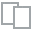
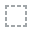
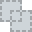
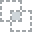
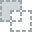
...
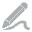
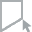
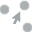
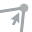
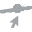

In [29]:
create_report(preped_train)

### ydata_profiling

In [30]:
from ydata_profiling import ProfileReport
profile = ProfileReport(df=preped_train)
profile.to_notebook_iframe()

Pandas backend loaded 1.5.3
Numpy backend loaded 1.23.5
Pyspark backend NOT loaded
Python backend loaded


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Descriptive Statistics

In [31]:
# statistics of numerical columns
preped_train.select_dtypes(exclude='object').describe().T

,count,mean,std,min,25%,50%,75%,max
temp,341880.0,28.296996,13.325830,21.55,24.98,26.20,28.39,177.26
d_point,341880.0,26.056234,12.080483,13.96,23.95,24.57,25.24,141.59
feels,341880.0,31.092778,15.228520,22.35,25.99,26.65,33.37,202.71
min_temp,341880.0,27.483902,12.924432,14.12,24.25,25.48,27.64,162.92
max_temp,341880.0,29.359565,13.802332,22.37,25.97,27.27,29.31,187.17
prssr,341880.0,1070.965439,494.701076,1001.00,1009.00,1010.00,1011.00,5115.51
hum,341880.0,94.221361,44.888444,29.00,83.00,92.00,96.00,503.00
wind_spd,341880.0,1.474819,1.104015,0.00,0.88,1.27,1.80,25.00
wind_deg,341880.0,210.867372,147.667380,0.00,149.00,203.00,279.00,1810.80
rain_1h,341880.0,0.338298,0.953114,-1.00,0.00,0.00,0.23,27.10


- `temp` --> max mencapai 177 which is impossible
- `rain_1h` --> seharusnya tidak boleh mencapai angka -1.00
- `prssr` --> mean berada di nilai 1070 namun terdapat beberapa record data yang mencapai nilai ~5000

## Univariate Analysis

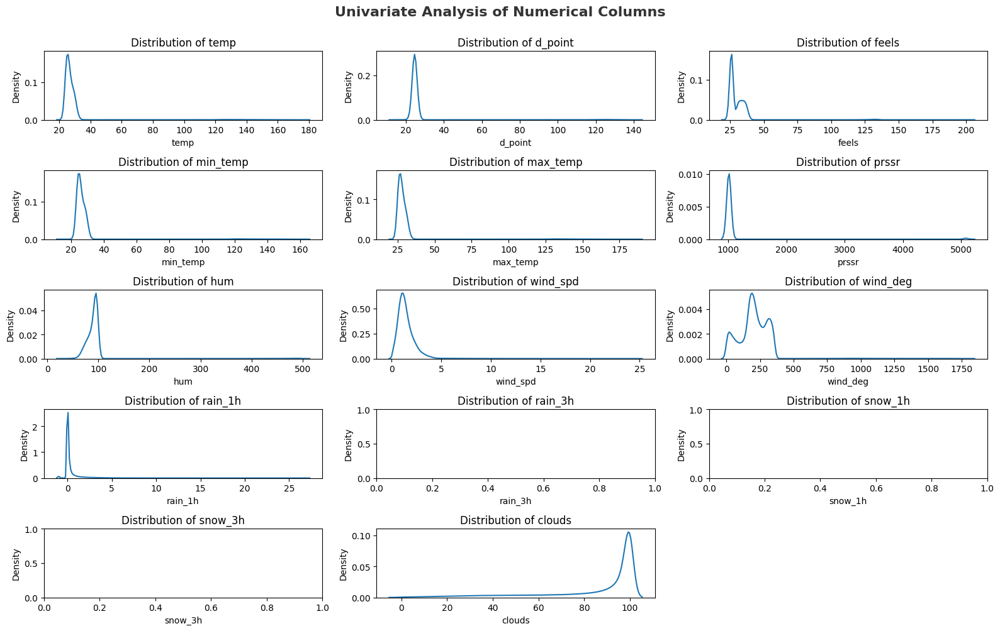

In [32]:
# Filter the DataFrame to include only numerical columns
numerical_columns = preped_train.select_dtypes(include=['number'])

# Determine the number of rows and columns for subplots dynamically
num_numerical_cols = len(numerical_columns.columns)
num_subplot_cols = 3  # Number of columns for subplots

num_subplot_rows = (num_numerical_cols + num_subplot_cols - 1) // num_subplot_cols  # Calculate number of rows

# Create subplots
plt.figure(figsize=(16, 10))
plt.suptitle('Univariate Analysis of Numerical Columns', fontsize=16, fontweight='bold', alpha=0.8, y=1.)
for i, column in enumerate(numerical_columns.columns):
    plt.subplot(num_subplot_rows, num_subplot_cols, i + 1)
    sns.kdeplot(data=numerical_columns[column])
    plt.title(f'Distribution of {column}')

plt.tight_layout()
plt.show()

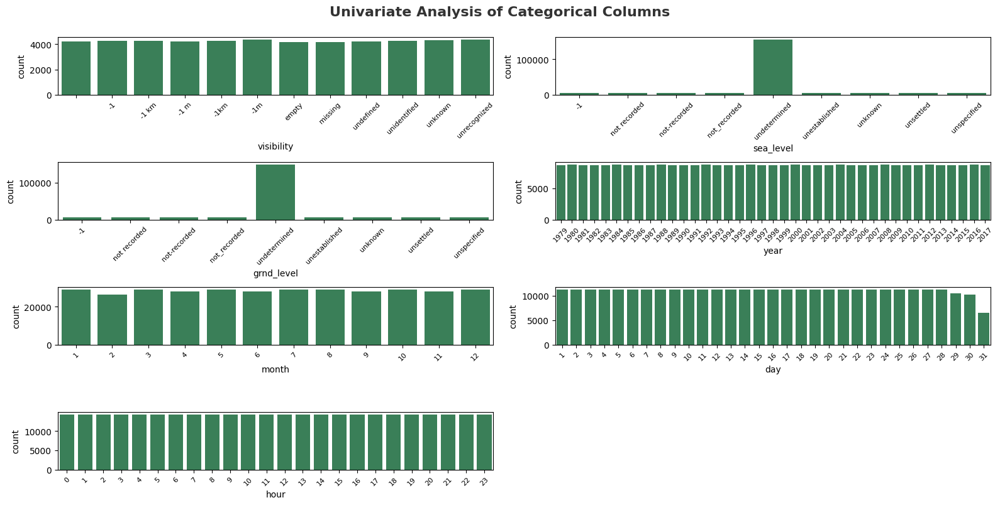

In [33]:
# categorical columns
plt.figure(figsize=(16, 8))
plt.suptitle('Univariate Analysis of Categorical Columns', fontsize=16, fontweight='bold', alpha=0.8, y=1.)
num_cat_cols = len(cat_cols)
num_rows = (num_cat_cols + 1) // 2  # Calculate the number of rows needed for 2 columns
for i in range(0, num_cat_cols):
    plt.subplot(num_rows, 2, i+1)  # Use 2 columns
    sns.countplot(x=preped_train[cat_cols[i]], color='seagreen')
    plt.xticks(rotation=45, fontsize=8)  # Rotate x-axis labels by 45 degrees and set fontsize
    plt.tight_layout()

# If there are more than 6 categorical columns, you can decide how to handle them.
# The number of rows will adjust accordingly for 2 columns.


<Axes: >

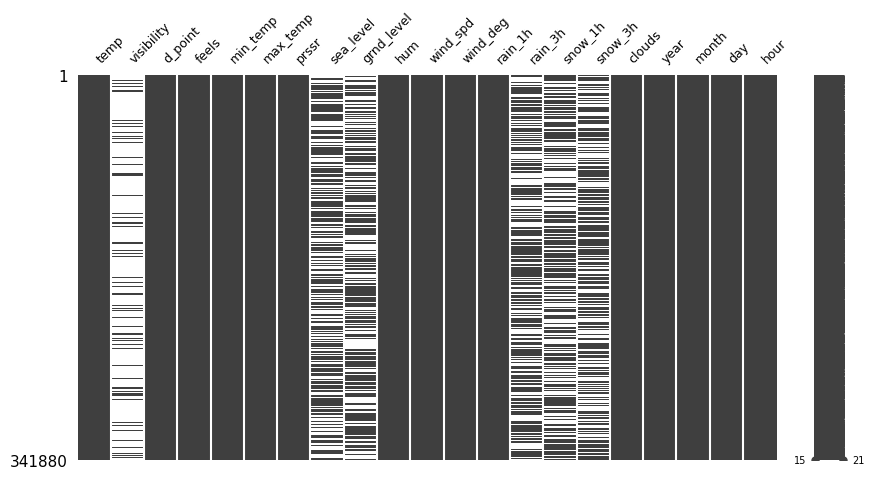

In [34]:
mno.matrix(preped_train, figsize=(10, 5), fontsize=9)

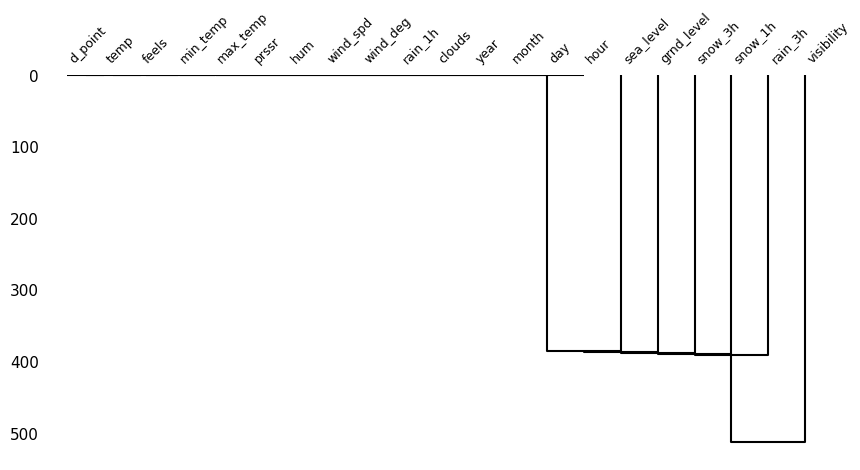

In [35]:
mno.dendrogram(train_dat, figsize=(10,5), fontsize=9);

<Axes: >

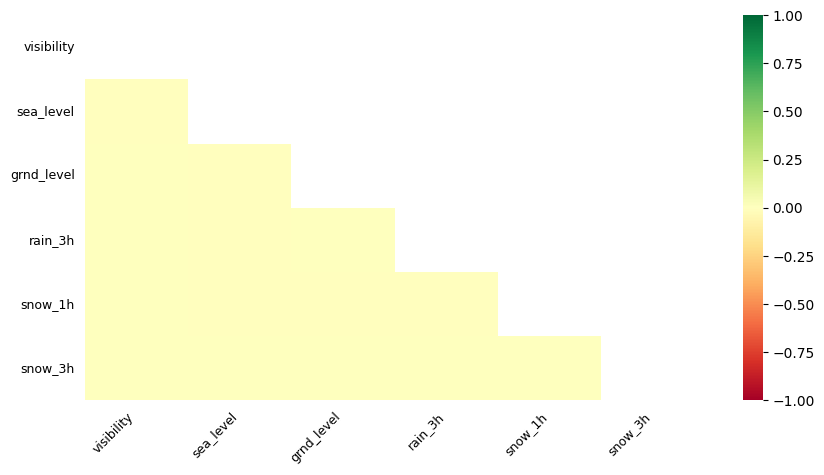

In [36]:
mno.heatmap(train_dat, cmap="RdYlGn", figsize=(10, 5), fontsize=9)

# Data preparation II

## vtreat

In [37]:
transform = vtreat.NumericOutcomeTreatment(
    outcome_name="rain_1h",
    params=vtreat.vtreat_parameters({
        "missingness_imputation": np.mean,
        "filter_to_recommended": False
    })
)

transformed_train = transform.fit_transform(preped_train)
transformed_test = transform.transform(preped_test)
transform.score_frame_

,variable,orig_variable,treatment,y_aware,has_range,PearsonR,R2,significance,vcount,default_threshold,recommended
0,snow_1h_is_bad,snow_1h,missing_indicator,False,True,0.001202,1.444011e-06,4.822924e-01,6.0,0.027778,False
1,visibility_is_bad,visibility,missing_indicator,False,True,0.000579,3.347306e-07,7.351483e-01,6.0,0.027778,False
2,sea_level_is_bad,sea_level,missing_indicator,False,True,-0.000632,3.993124e-07,7.117695e-01,6.0,0.027778,False
3,rain_3h_is_bad,rain_3h,missing_indicator,False,True,0.001743,3.036715e-06,3.082437e-01,6.0,0.027778,False
4,grnd_level_is_bad,grnd_level,missing_indicator,False,True,0.001847,3.411539e-06,2.801565e-01,6.0,0.027778,False
5,snow_3h_is_bad,snow_3h,missing_indicator,False,True,-0.001694,2.869954e-06,3.219091e-01,6.0,0.027778,False
6,day,day,clean_copy,False,True,-0.008735,7.630048e-05,3.264731e-07,14.0,0.011905,True
7,hum,hum,clean_copy,False,True,-0.020409,4.165259e-04,7.829798e-33,14.0,0.011905,True
8,prssr,prssr,clean_copy,False,True,0.000508,2.580524e-07,7.664494e-01,14.0,0.011905,False
9,clouds,clouds,clean_copy,False,True,0.122397,1.498115e-02,0.000000e+00,14.0,0.011905,True


In [38]:
transformed_train.head(3)

,rain_1h,snow_1h_is_bad,visibility_is_bad,sea_level_is_bad,rain_3h_is_bad,grnd_level_is_bad,snow_3h_is_bad,day,hum,prssr,...,sea_level_impact_code,sea_level_deviation_code,sea_level_prevalence_code,sea_level_lev_undetermined,sea_level_lev__NA_,grnd_level_impact_code,grnd_level_deviation_code,grnd_level_prevalence_code,grnd_level_lev__NA_,grnd_level_lev_undetermined
0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,95.0,1012.0,...,0.000276,0.958626,0.452153,1.0,0.0,0.000000,0.958104,0.435711,1.0,0.0
1,0.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,95.0,1012.0,...,0.000000,0.950688,0.435580,0.0,1.0,0.000000,0.958104,0.435711,1.0,0.0
2,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,86.0,1012.0,...,0.000000,0.946613,0.435580,0.0,1.0,0.001728,0.955790,0.435281,0.0,1.0


In [39]:
transformed_test.head(3)

,snow_1h_is_bad,visibility_is_bad,sea_level_is_bad,rain_3h_is_bad,grnd_level_is_bad,snow_3h_is_bad,day,hum,prssr,clouds,...,sea_level_impact_code,sea_level_deviation_code,sea_level_prevalence_code,sea_level_lev_undetermined,sea_level_lev__NA_,grnd_level_impact_code,grnd_level_deviation_code,grnd_level_prevalence_code,grnd_level_lev__NA_,grnd_level_lev_undetermined
0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,84.0,1009.0,97.0,...,0.000558,0.962013,0.452153,1.0,0.0,0.000000,0.959325,0.435711,1.0,0.0
1,0.0,1.0,1.0,0.0,1.0,0.0,1.0,91.0,1009.0,95.0,...,0.000000,0.948458,0.435580,0.0,1.0,0.000000,0.959325,0.435711,1.0,0.0
2,0.0,0.0,1.0,0.0,0.0,0.0,1.0,84.0,1009.0,90.0,...,0.000000,0.948458,0.435580,0.0,1.0,0.000851,0.950809,0.435281,0.0,1.0


## PyCaret

In [40]:
from pycaret.regression import *

In [41]:
cat_features = preped_train.select_dtypes(include=['category'])
cat_features.columns

Index(['visibility', 'sea_level', 'grnd_level', 'year', 'month', 'day',
       'hour'],
      dtype='object')

In [42]:
s = setup(
    data=preped_train, 
    target='rain_1h',
    use_gpu=False
)

,Description,Value
0,Session id,3322
1,Target,rain_1h
2,Target type,Regression
3,Original data shape,"(341880, 21)"
4,Transformed data shape,"(341880, 82)"
5,Transformed train set shape,"(239315, 82)"
6,Transformed test set shape,"(102565, 82)"
7,Numeric features,13
8,Categorical features,7
9,Rows with missing values,99.1%


## Train-Test-Validation Split

In [43]:
from fast_ml.model_development import train_valid_test_split

X_train, y_train, X_valid, y_valid, X_test, y_test = train_valid_test_split(
                                        transformed_train,
                                        target = 'rain_1h',
                                        train_size=0.7, valid_size=0.15, test_size=0.15)

# Machine Learning I

In [44]:
params = {
        'iterations': 35000,
        'eval_metric': "RMSE",
        'task_type': "GPU",
        'verbose':True,
        'od_type':'Iter'}

cat_regressor = CatBoostRegressor(**params)

In [45]:
cat_regressor.fit(X_train, y_train, plot=True);

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Learning rate set to 0.009912
0:	learn: 0.9536173	total: 7.08ms	remaining: 4m 7s
1:	learn: 0.9518856	total: 14.3ms	remaining: 4m 9s
2:	learn: 0.9501921	total: 21.3ms	remaining: 4m 8s
3:	learn: 0.9485260	total: 28.2ms	remaining: 4m 6s
4:	learn: 0.9468956	total: 34.7ms	remaining: 4m 2s
5:	learn: 0.9452831	total: 41.3ms	remaining: 4m
6:	learn: 0.9437106	total: 47.6ms	remaining: 3m 58s
7:	learn: 0.9421332	total: 53.8ms	remaining: 3m 55s
8:	learn: 0.9406096	total: 60.2ms	remaining: 3m 53s
9:	learn: 0.9391028	total: 66.3ms	remaining: 3m 52s
10:	learn: 0.9376218	total: 72.8ms	remaining: 3m 51s
11:	learn: 0.9361669	total: 79ms	remaining: 3m 50s
12:	learn: 0.9347891	total: 85.4ms	remaining: 3m 49s
13:	learn: 0.9333751	total: 91.5ms	remaining: 3m 48s
14:	learn: 0.9320119	total: 97.8ms	remaining: 3m 48s
15:	learn: 0.9306901	total: 104ms	remaining: 3m 47s
16:	learn: 0.9293434	total: 110ms	remaining: 3m 46s
17:	learn: 0.9280617	total: 117ms	remaining: 3m 46s
18:	learn: 0.9268038	total: 123ms	remain

In [46]:
y_pred = cat_regressor.predict(X_test)
print('RMSE:', np.sqrt(mean_squared_error(y_test, y_pred)))

RMSE: 0.808503179298299


## PyCaret ML

# Evaluation

## Explainable AI

Explainable AI is a research field on ML interpretability techniques whose aims are to understand machine learning model predictions and explain them in human and understandable terms **to build trust with stakeholders**.

- *Interpretability* focuses on model understanding techniques.
- While *explainability* more broadly focuses on model explanations and the interface for translating these explanations in human, understandable terms for different stakeholders.

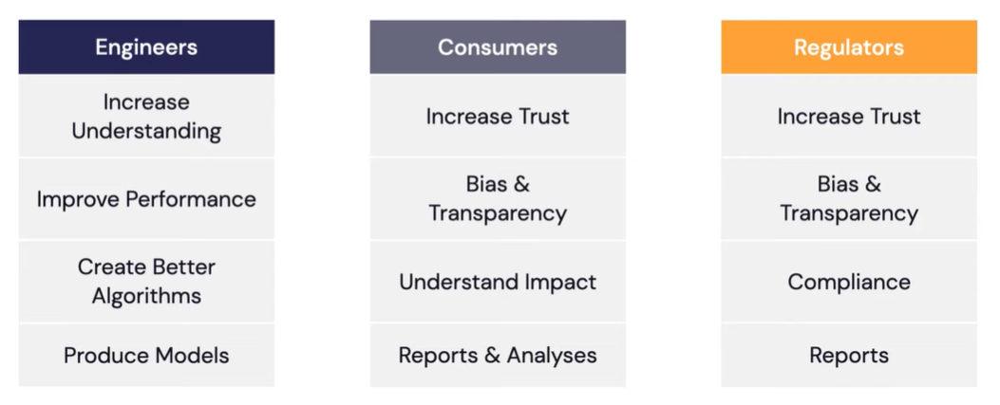

### SHAP (SHapley Additive exPlanations)

In [47]:
#pip install shap

In [48]:
import shap
from catboost import Pool

shap_values = cat_regressor.get_feature_importance(Pool(X_test, label=y_test), type="ShapValues")
shap_values = shap_values[:,:-1]

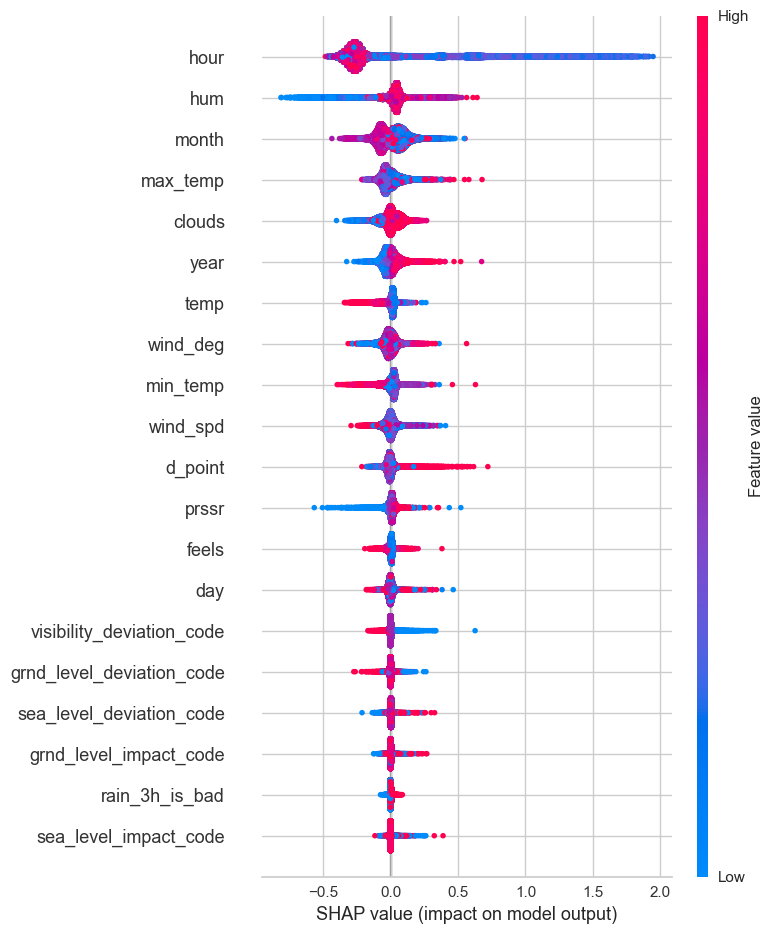

In [49]:
shap.summary_plot(shap_values, X_test)

### LIME (Local Interpretable Model-Agnostic Explanations)

In [50]:
#pip install lime

In [51]:
import lime
from lime.lime_tabular import LimeTabularExplainer

# Submission

In [52]:
submission = pd.read_csv(SAMPLE_SUBMISSION_PATH)

In [53]:
submission['rain_1h'] = cat_regressor.predict(transformed_test)
submission.to_csv('rain_prediction_submission.csv', index=False)